This notebook must be run on a TFOD Python environment
(e.g launch it from Charlie's TFOD docker)

Written by Charlotte Weil ~ May 28, 2019.
Inspired from:
* https://github.com/microsoft/CameraTraps/blob/master/data_management/tfrecords/tools/inspect_tfrecords.ipynb

# Inspecting TFRecords



### Imports

In [1]:
print('Good morning sunshine')

Good morning sunshine


In [2]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile

import tensorflow as tf
import zipfile


from collections import defaultdict
import io
from io import StringIO

from matplotlib import pyplot as plt


import PIL
from PIL import Image

import glob

sys.path.append("..")
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util 
from object_detection.utils import visualization_utils as vis_utils

ImportError: No module named 'object_detection'

### Utils

In [8]:
def inspect_tfrecord(TFRECORDS_PATH,
                        only_first_image=False):
    
    record_iterator = tf.python_io.tf_record_iterator(TFRECORDS_PATH)

    for string_record in record_iterator:
        example = tf.train.Example()
        example.ParseFromString(string_record)
        
        ## Print infos:
        
        #temp
        label = example.features.feature['image/object/class/label'].bytes_list.value
        text = example.features.feature['image/object/class/text'].int64_list.value
        print(label, text)
        
        fn = example.features.feature['image/filename'].bytes_list.value
        fid= example.features.feature['image/id'].int64_list.value
        print(fn, 'id: ', fid)

        w = example.features.feature['image/width'].int64_list.value[0]
        h = example.features.feature['image/height'].int64_list.value[0]
        print('Image size: ',w,'*',h)

        bb_y0 = example.features.feature['image/object/bbox/ymin'].float_list.value
        bb_y1 = example.features.feature['image/object/bbox/ymax'].float_list.value
        bb_x0 = example.features.feature['image/object/bbox/xmin'].float_list.value
        bb_x1 = example.features.feature['image/object/bbox/xmax'].float_list.value
        
        for i in range(0,len(bb_y0)):
                print('Object BBox - Bounding box ',i,' at: ', bb_y0[i], bb_y1[i], bb_x0[i], bb_x1[i])

        bb_y0_pred = example.features.feature['image/detection/bbox/ymin'].float_list.value
        bb_y1_pred = example.features.feature['image/detection/bbox/ymax'].float_list.value
        bb_x0_pred = example.features.feature['image/detection/bbox/xmin'].float_list.value
        bb_x1_pred = example.features.feature['image/detection/bbox/xmax'].float_list.value
        print('Detection - Bounding box at', bb_y0_pred, bb_y1_pred, bb_x0_pred, bb_x1_pred)

        ## Other things of interest could include:
        # label= example.features.feature['image/class/label'].int64_list.value
        # print(label)
        # fid= example.features.feature['image/class/text'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/class/conf'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/label'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/text'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/conf'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/score'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/parts/x'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/detection/bbox/xmin'].int64_list.value
        # print(fid)

        ## See https://github.com/microsoft/CameraTraps/blob/master/data_management/tfrecords/tools/iterate_tfrecords.py 
        ## for more attributes.

        
        encoded = example.features.feature["image/encoded"].bytes_list.value[0]
        img = PIL.Image.open(io.BytesIO(encoded))
        
        
#         if bb_y0 is True:
#             vis_utils.draw_bounding_box_on_image(img,
#                                ymin=bb_y0[0],xmin=bb_x0[0],ymax=bb_y1[0],xmax=bb_x1[0],
#                                color='blue',
#                                thickness=4,
#                                display_str_list=('dam'),
#                                use_normalized_coordinates=False)
#         if bb_y0_pred is True:
#             vis_utils.draw_bounding_box_on_image(img,
#                                ymin=bb_y0_pred[0],xmin=bb_x0_pred[0],ymax=bb_y1_pred[0],xmax=bb_x1_pred[0],
#                                color='red',
#                                thickness=4,
#                                display_str_list=('predicted'),
#                                use_normalized_coordinates=False)
        
        display(img)
        
        if only_first_image == True:
            break


In [ ]:
# Workflow to inspect tfrecords

In [ ]:
dataset_path = dataset_path_0527_bbtoobig

sess = tf.InteractiveSession()

for i in range(0,len(list(glob.glob(dataset_path)))):
    
    TFRECORDS_PATH = list(glob.glob(dataset_path))[i]
    
    inspect_tfrecord(TFRECORDS_PATH,only_first_image=True)
    

# Experimental

In [7]:
# How many instances in the .record file?

TFRECORDS_PATH = '../../../../charlie/data/05-27/dam_training_9.record'

record_iterator = tf.python_io.tf_record_iterator(TFRECORDS_PATH)
i=0
for string_record in record_iterator:
    i+=1
        
print(i)

383


[] []
[b'workspace/dam_images/98583_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  203.0 216.0 194.0 226.0
Detection - Bounding box at [] [] [] []


/usr/local/lib/python3.5/dist-packages/tensorflow/python/client/session.py:1714: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


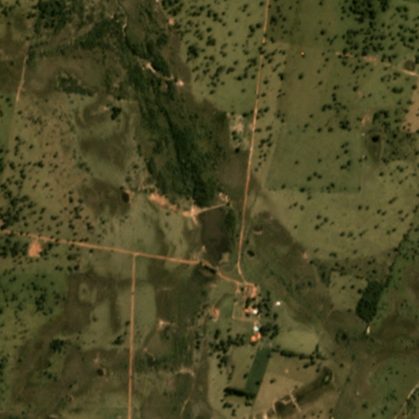

In [37]:
sess = tf.InteractiveSession()

dataset_path = '../../../../charlie/data/05-27/dam_train*'

i = 21#4#10
TFRECORDS_PATH = list(glob.glob(dataset_path))[i]

inspect_tfrecord(TFRECORDS_PATH,only_first_image=True)

sess.close()

False
Object BBox - Bounding box at [203.0] [216.0] [194.0] [226.0]


/usr/local/lib/python3.5/dist-packages/tensorflow/python/client/session.py:1714: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


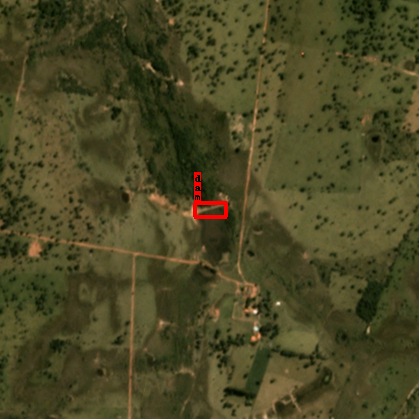

In [35]:
#Test on one image
sess = tf.InteractiveSession()

dataset_path = '../../../../charlie/data/05-27/dam_train*'

#for i in range(0,len(list(glob.glob(dataset_path)))):
i = 21#4#10
TFRECORDS_PATH = list(glob.glob(dataset_path))[i]
#print(TFRECORDS_PATH)

record_iterator = tf.python_io.tf_record_iterator(TFRECORDS_PATH)
for string_record in record_iterator:
    example = tf.train.Example()
    example.ParseFromString(string_record)
    break ## Just interested in the first record:
    
w = example.features.feature['image/width'].int64_list.value[0]
h = example.features.feature['image/height'].int64_list.value[0]
bb_y0 = example.features.feature['image/object/bbox/ymin'].float_list.value
bb_y1 = example.features.feature['image/object/bbox/ymax'].float_list.value
bb_x0 = example.features.feature['image/object/bbox/xmin'].float_list.value
bb_x1 = example.features.feature['image/object/bbox/xmax'].float_list.value

print('Object BBox - Bounding box at', bb_y0, bb_y1, bb_x0, bb_x1)

encoded = example.features.feature["image/encoded"].bytes_list.value[0]
img = PIL.Image.open(io.BytesIO(encoded))

ymin = bb_y0[0]
xmin = bb_x0[0]
ymax = bb_y1[0]
xmax = bb_x1[0]

vis_utils.draw_bounding_box_on_image(img,
                               ymin,xmin,ymax,xmax,
                               color='red',
                               thickness=4,
                               display_str_list=('dam'),
                               use_normalized_coordinates=False)

display(img)

sess.close()

In [5]:
#Test on one image

record_iterator = tf.python_io.tf_record_iterator(TFRECORDS_PATH)

for string_record in record_iterator:
    example = tf.train.Example()
    example.ParseFromString(string_record)
        
encoded = example.features.feature["image/encoded"].bytes_list.value[0]
img = PIL.Image.open(io.BytesIO(encoded))

vis_utils.draw_bounding_box_on_image(img,
                               0.1,0.8,0.9,0.9,
                               color='red',
                               thickness=4,
                               display_str_list=('dam'),
                               use_normalized_coordinates=True)

display(img)

NameError: name 'TFRECORDS_PATH' is not defined

In [14]:
vis_utils.draw_bounding_box_on_image(img,
                               0.1,0.8,0.9,0.9,
                               color='red',
                               thickness=4,
                               display_str_list=('dam'),
                               use_normalized_coordinates=True)

display(img)

NameError: name 'img' is not defined

## Inspect TFRecords 
Inspired by https://github.com/microsoft/CameraTraps/blob/master/data_management/tfrecords/tools/inspect_tfrecords.ipynb

In [9]:
dataset_path_0529_1 = '../../../../charlie/data/05-29/dam_training_1.record*'

[] []
[b'workspace/dam_images/67370_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.4463007152080536 0.553699254989624 0.4797135889530182 0.5202863812446594
Detection - Bounding box at [] [] [] []


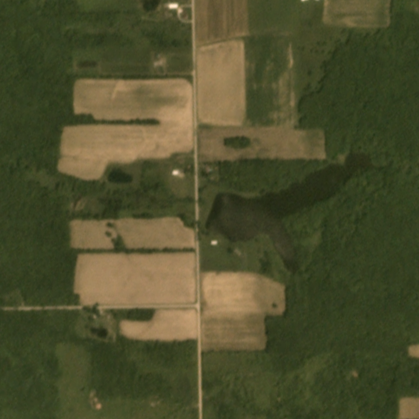

[] []
[b'workspace/dam_images/114228_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.482100248336792 0.5202863812446594 0.4439140856266022 0.553699254989624
Detection - Bounding box at [] [] [] []


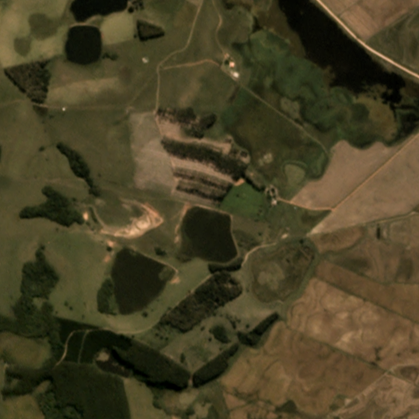

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/19.239_-3.8352500000000003_19.256999999999998_-3.81725.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


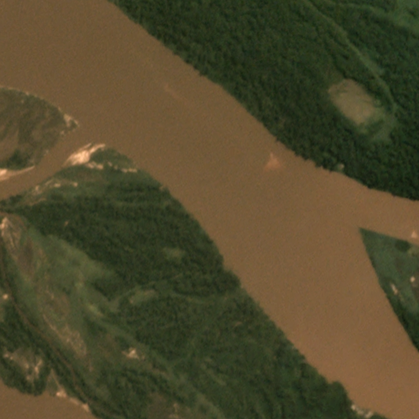

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/69.67425_-49.04325_69.69225_-49.02525.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


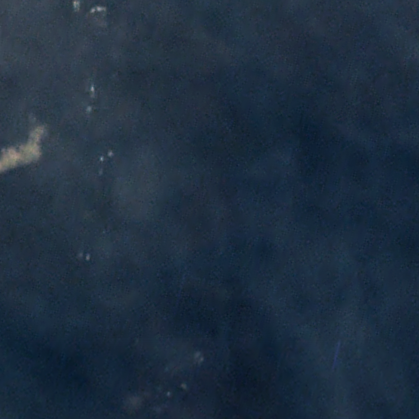

[] []
[b'workspace/dam_images/64130_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.4534606337547302 0.5465393662452698 0.4295942783355713 0.5656324625015259
Detection - Bounding box at [] [] [] []


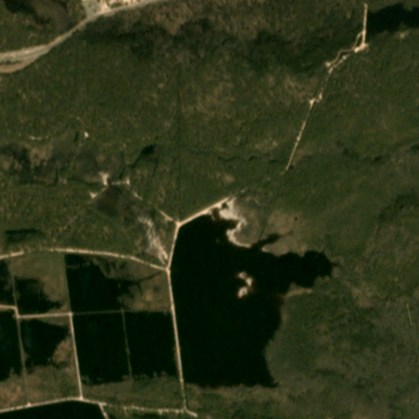

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/117.16325_48.61375_117.18125_48.63175.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


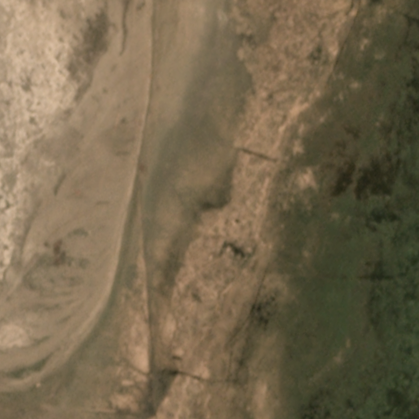

[] []
[b'workspace/dam_images/117812_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.47255370020866394 0.5250596404075623 0.4534606337547302 0.5441527366638184
Detection - Bounding box at [] [] [] []


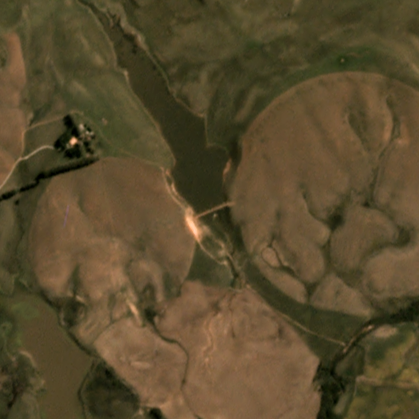

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/124.16425_-28.70175_124.18225_-28.68375.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


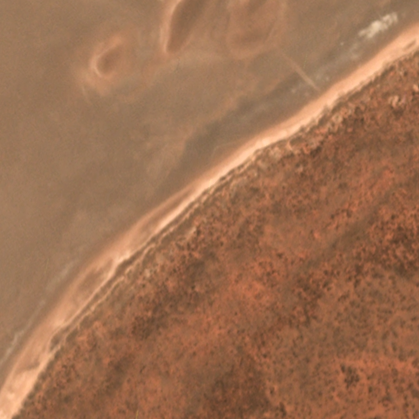

[] []
[b'workspace/dam_images/105523_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.4868735074996948 0.5155131220817566 0.49164676666259766 0.5059666037559509
Detection - Bounding box at [] [] [] []


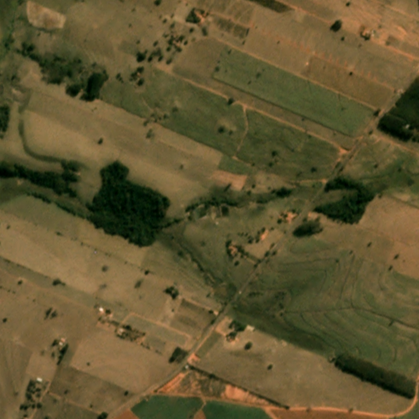

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/16.4765_-18.665750000000003_16.494500000000002_-18.647750000000002.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


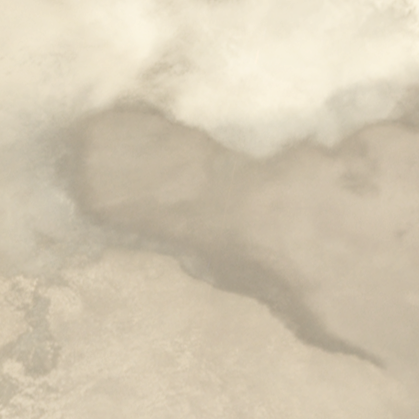

[] []
[b'workspace/dam_images/106971_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.4868735074996948 0.5107398629188538 0.48926013708114624 0.5107398629188538
Detection - Bounding box at [] [] [] []


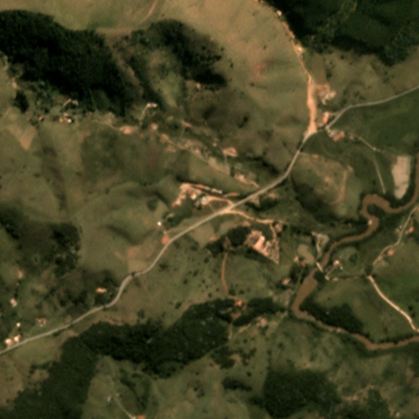

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/-133.60475_58.64675_-133.58675_58.66475.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


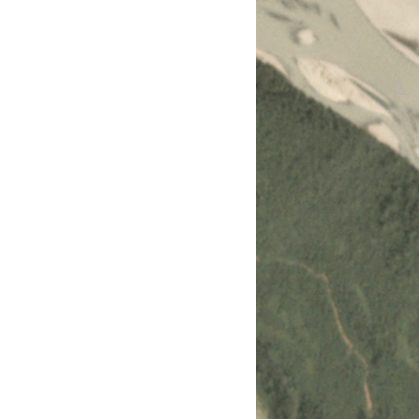

[] []
[b'workspace/dam_images/7368_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.3293555974960327 0.6706444025039673 0.47255370020866394 0.5298329591751099
Detection - Bounding box at [] [] [] []


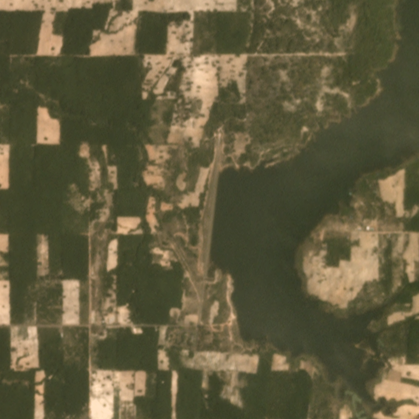

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/161.9675_58.138_161.9855_58.156.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


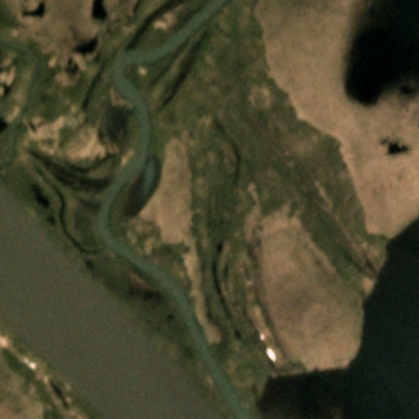

[] []
[b'workspace/dam_images/97468_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.43675416707992554 0.5632458329200745 0.40334129333496094 0.5942720770835876
Detection - Bounding box at [] [] [] []


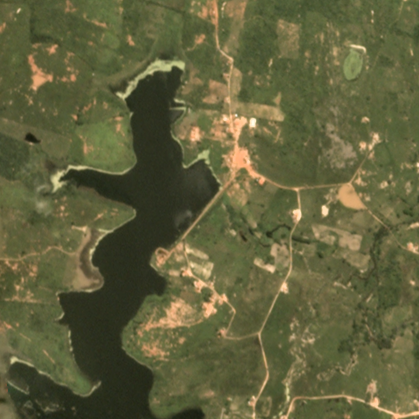

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/26.985_46.615_27.003_46.633.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


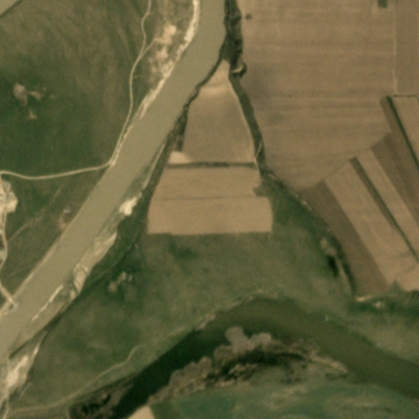

[] []
[b'workspace/dam_images/49684_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.4606205224990845 0.5393794775009155 0.4797135889530182 0.5202863812446594
Detection - Bounding box at [] [] [] []


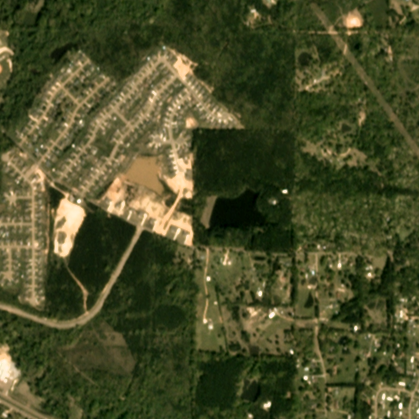

[] []
[b'workspace/dam_images/1989_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.33412888646125793 0.6682577729225159 0.20286396145820618 0.7923627495765686
Detection - Bounding box at [] [] [] []


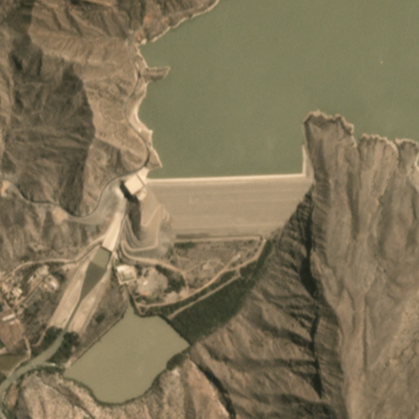

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/9.50075_-1.187_9.51875_-1.169.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


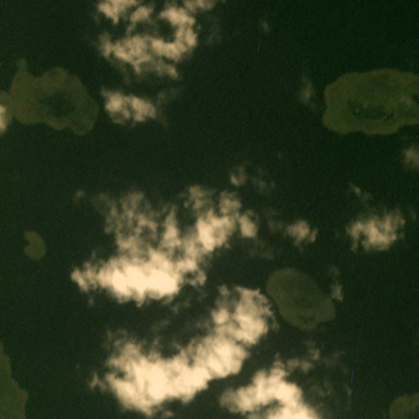

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/-37.25475_-5.77825_-37.23675_-5.76025.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


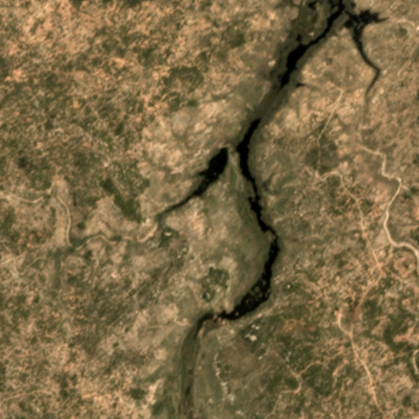

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/117.353_3.27475_117.371_3.29275.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


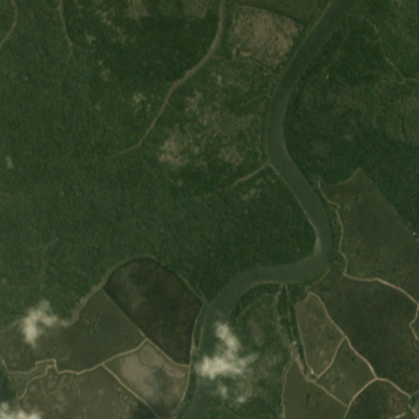

[] []
[b'workspace/dam_images/110919_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.42004773020744324 0.5823389291763306 0.40334129333496094 0.5966587066650391
Detection - Bounding box at [] [] [] []


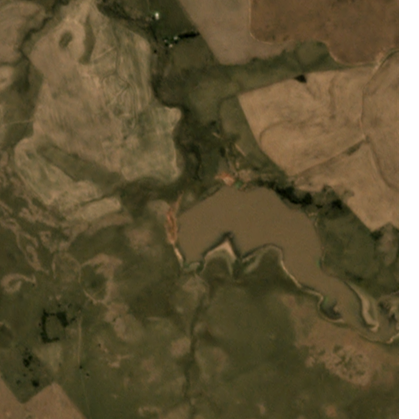

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/90.5735_68.35025_90.5915_68.36825.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


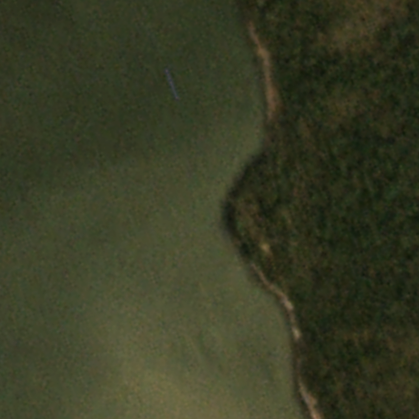

[] []
[b'workspace/dam_images/5778_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.42243435978889465 0.5751789808273315 0.4176611006259918 0.584725558757782
Detection - Bounding box at [] [] [] []


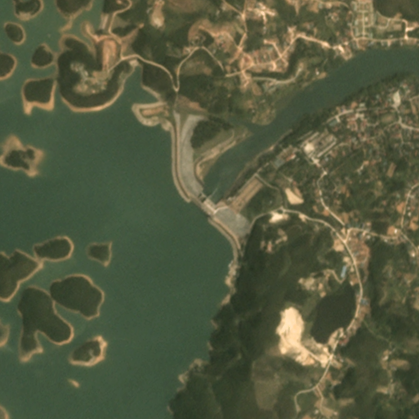

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/19.497500000000002_-33.64325_19.5155_-33.62525.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


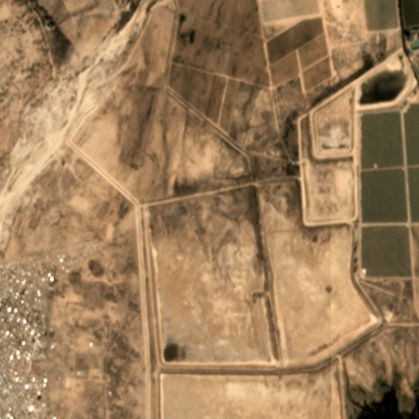

[] []
[b'workspace/dam_images/7927_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box  0  at:  0.3985680043697357 0.5990453362464905 0.30548927187919617 0.6921241283416748
Detection - Bounding box at [] [] [] []


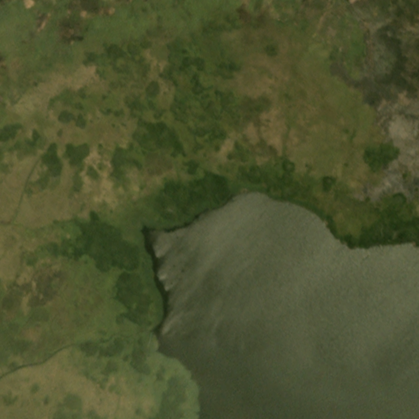

[] []
[b'../natgeo-dam-classification/workspace_not_a_dam/not_dam_images/140.65825_62.99875_140.67625_63.01675.png'] id:  []
Image size:  419 * 419
Detection - Bounding box at [] [] [] []


In [ ]:
dataset_path = dataset_path_0529_1

sess = tf.InteractiveSession()

for i in range(0,len(list(glob.glob(dataset_path)))):
    
    TFRECORDS_PATH = list(glob.glob(dataset_path))[i]
    
    inspect_tfrecord(TFRECORDS_PATH,only_first_image=False)
    
sess.close()

/usr/local/lib/python3.5/dist-packages/tensorflow/python/client/session.py:1714: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


[] []
[b'workspace/dam_images/16517_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


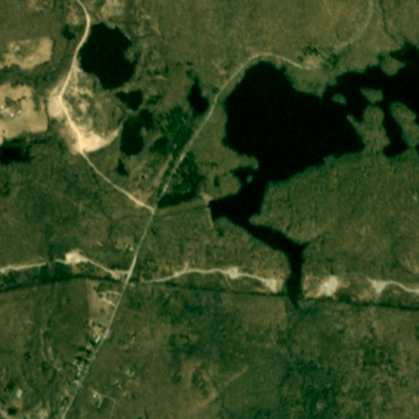

[] []
[b'workspace/dam_images/117370_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


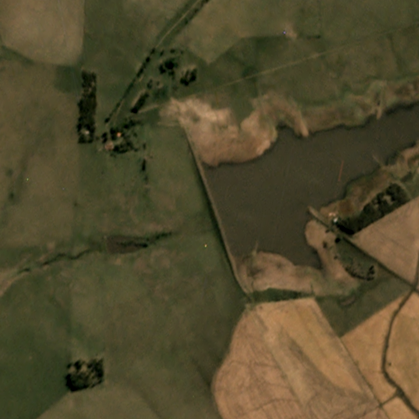

[] []
[b'workspace/dam_images/100461_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


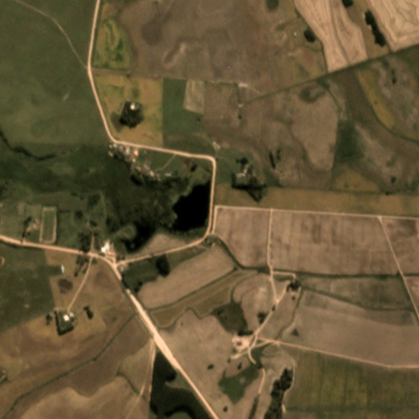

[] []
[b'workspace/dam_images/115077_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


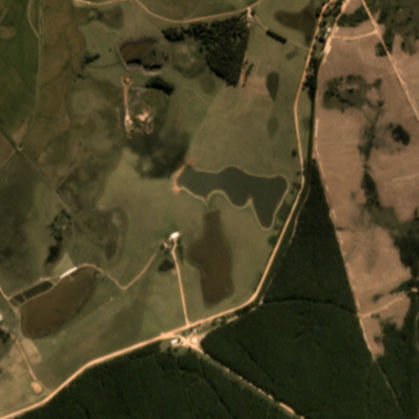

[] []
[b'workspace/not_a_dam_images/625-1318_not_a_dam.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


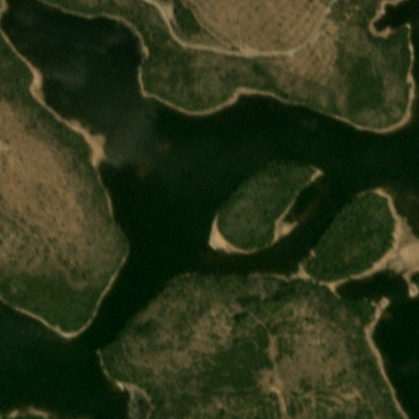

[] []
[b'workspace/dam_images/1224_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


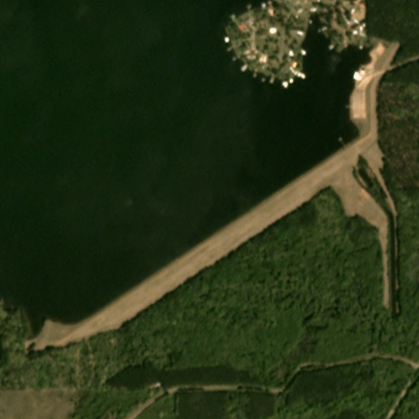

[] []
[b'workspace/dam_images/7389_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


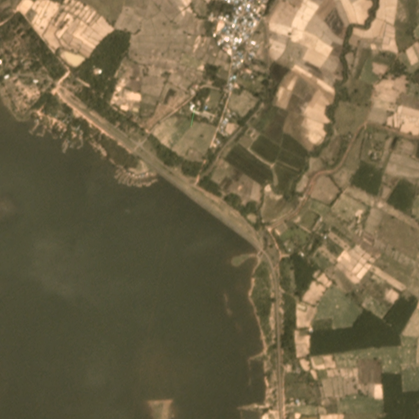

[] []
[b'workspace/dam_images/98056_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


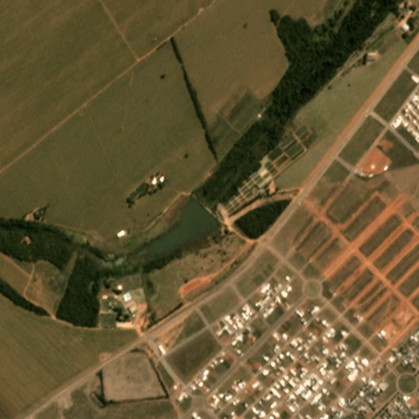

[] []
[b'workspace/dam_images/119388_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


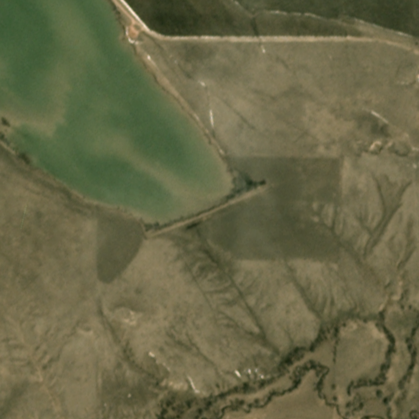

[] []
[b'workspace/dam_images/102965_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


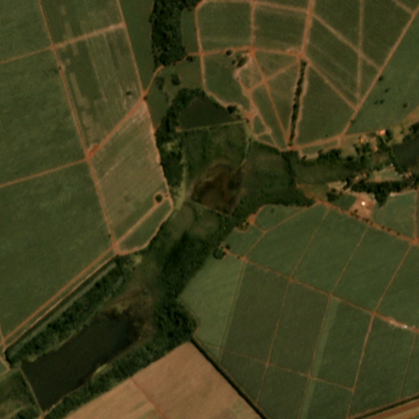

[] []
[b'workspace/dam_images/97681_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


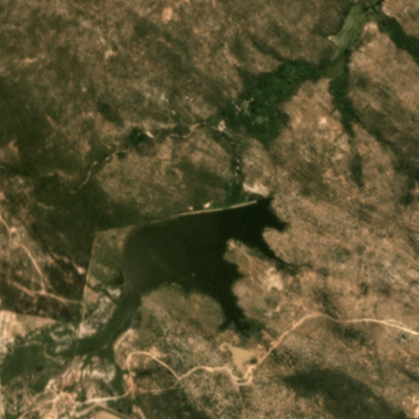

[] []
[b'workspace/dam_images/112238_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


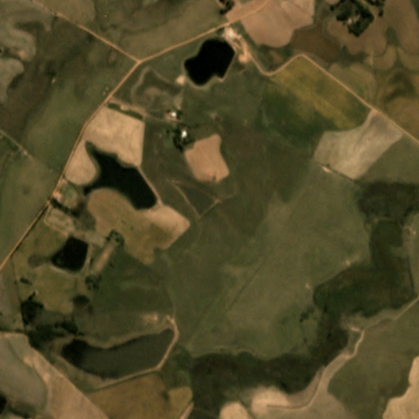

[] []
[b'workspace/dam_images/67370_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


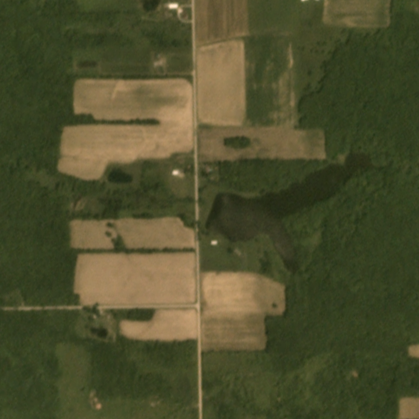

[] []
[b'workspace/dam_images/99572_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


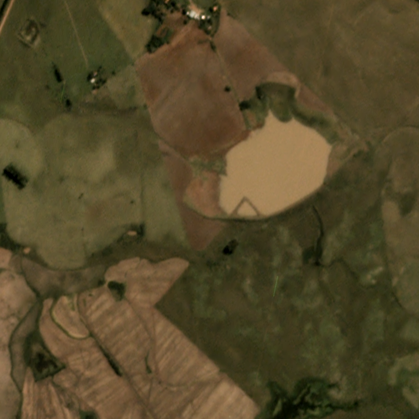

[] []
[b'workspace/dam_images/98459_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


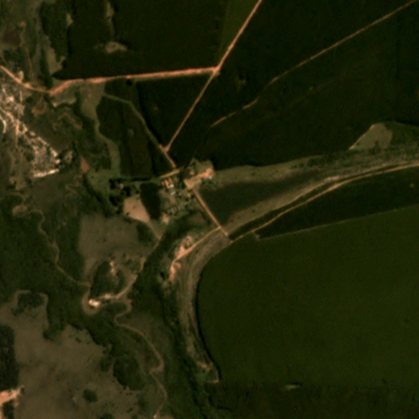

[] []
[b'workspace/dam_images/113569_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


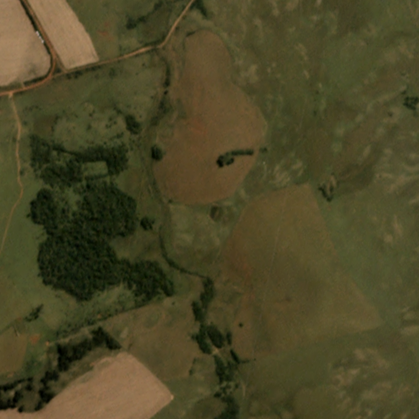

[] []
[b'workspace/dam_images/32732_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


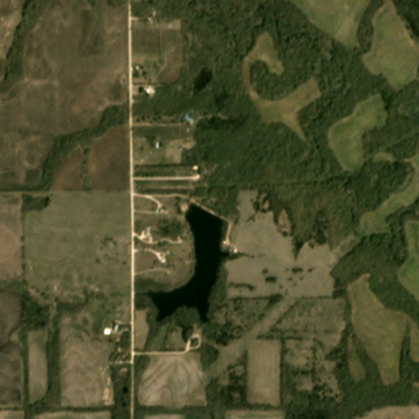

[] []
[b'workspace/dam_images/64970_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


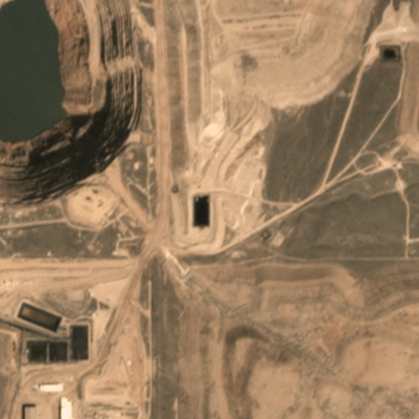

[] []
[b'workspace/dam_images/118247_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


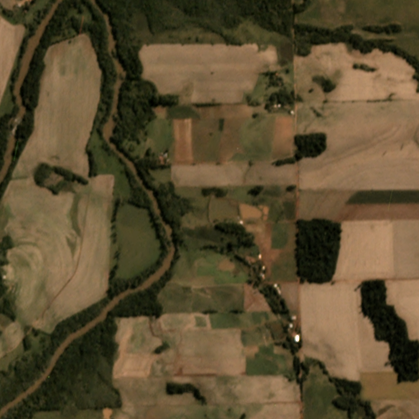

[] []
[b'workspace/dam_images/107866_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


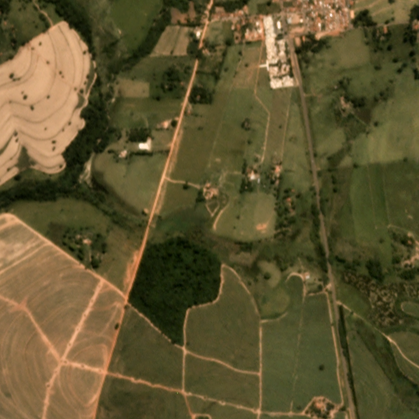

[] []
[b'workspace/dam_images/62720_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


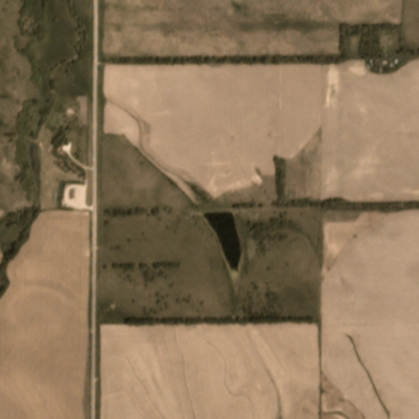

[] []
[b'workspace/dam_images/98583_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


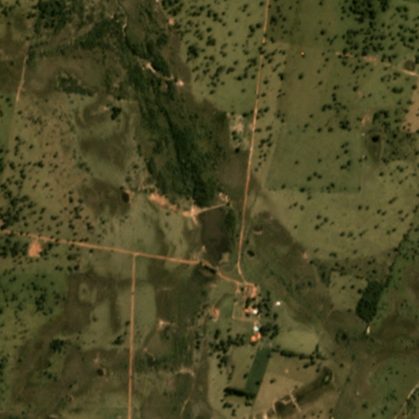

[] []
[b'workspace/dam_images/5679_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


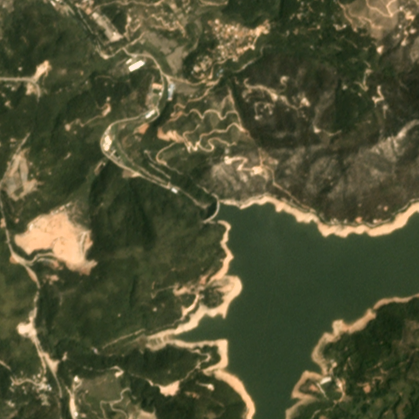

[] []
[b'workspace/dam_images/30391_clipped.png'] id:  []
Image size:  419 * 419
No BBox
Detection - Bounding box at [] [] [] []


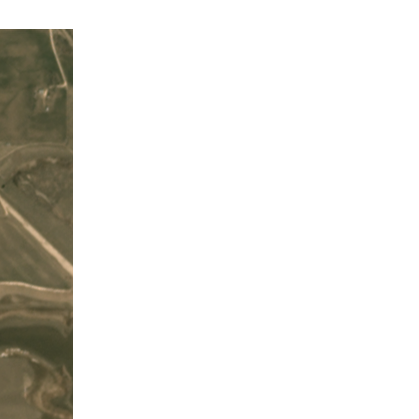

In [11]:
dataset_path = dataset_path_0527_bbtoobig

sess = tf.InteractiveSession()

for i in range(0,len(list(glob.glob(dataset_path)))):
    
    TFRECORDS_PATH = list(glob.glob(dataset_path))[i]
    
    inspect_tfrecord(TFRECORDS_PATH,only_first_image=True)
    

[] []
[b'workspace/not_a_dam_images/488-1208_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


/usr/local/lib/python3.5/dist-packages/tensorflow/python/client/session.py:1714: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


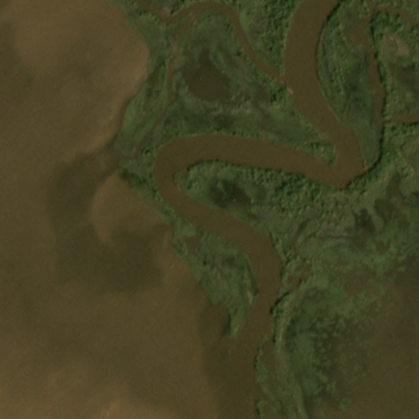

[] []
[b'workspace/not_a_dam_images/550-1269_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


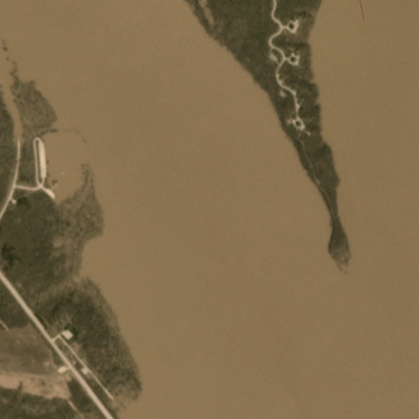

[] []
[b'workspace/dam_images/117812_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [198.0] [220.0] [190.0] [228.0]
Detection - Bounding box at [] [] [] []


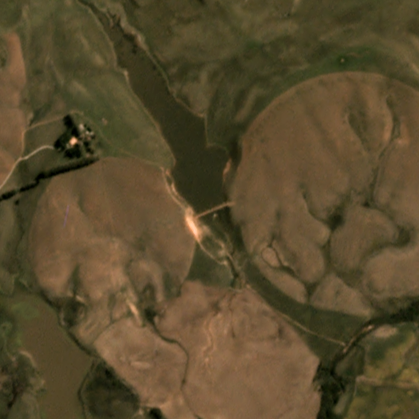

[] []
[b'workspace/dam_images/5001_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [165.0] [254.0] [178.0] [240.0]
Detection - Bounding box at [] [] [] []


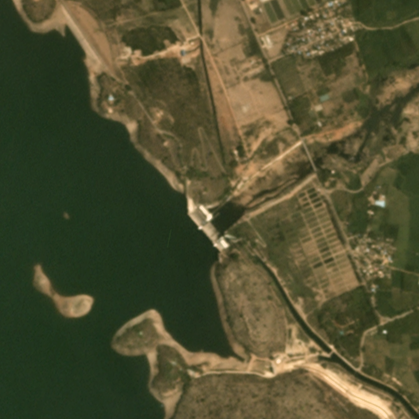

[] []
[b'workspace/dam_images/117582_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [200.0] [220.0] [206.0] [214.0]
Detection - Bounding box at [] [] [] []


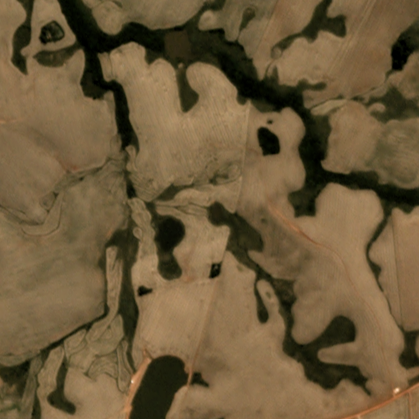

[] []
[b'workspace/dam_images/4997_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [136.0] [283.0] [189.0] [229.0]
Detection - Bounding box at [] [] [] []


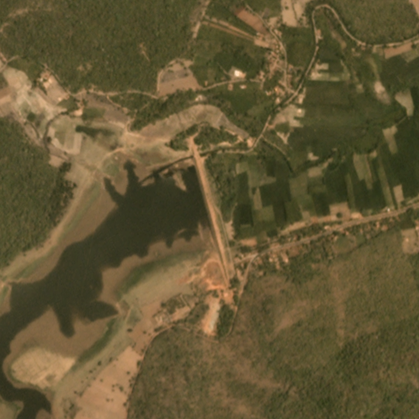

[] []
[b'workspace/not_a_dam_images/1032-1066_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


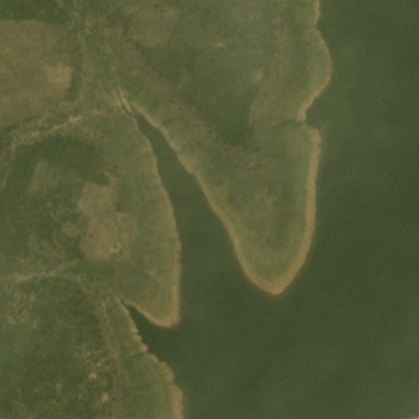

[] []
[b'workspace/dam_images/81281_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [196.0] [223.0] [196.0] [222.0]
Detection - Bounding box at [] [] [] []


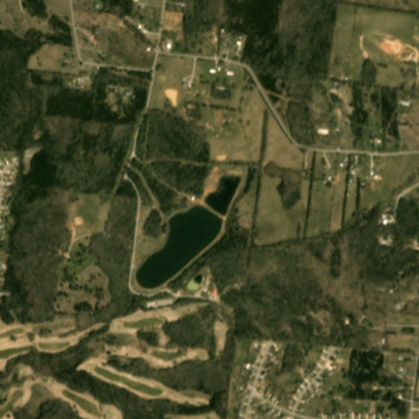

[] []
[b'workspace/dam_images/9592_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [200.0] [219.0] [191.0] [227.0]
Detection - Bounding box at [] [] [] []


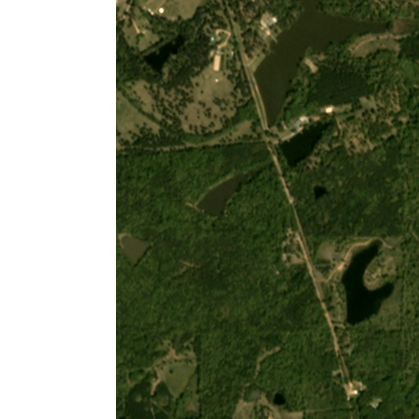

[] []
[b'workspace/not_a_dam_images/520-1228_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


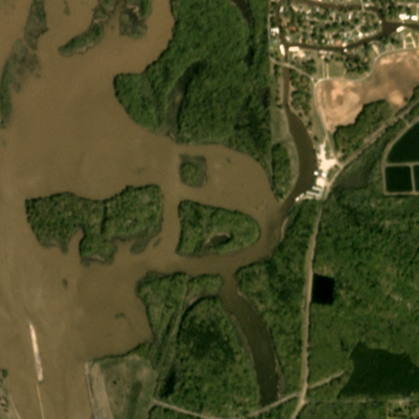

[] []
[b'workspace/dam_images/120019_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [145.0] [275.0] [191.0] [226.0]
Detection - Bounding box at [] [] [] []


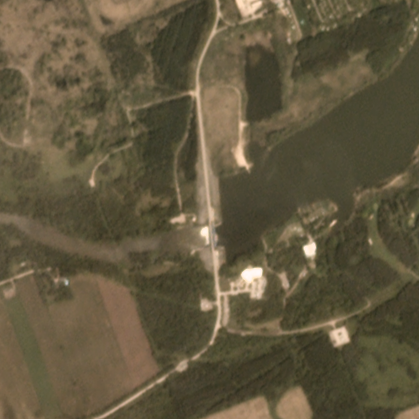

[] []
[b'workspace/not_a_dam_images/408-1327_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


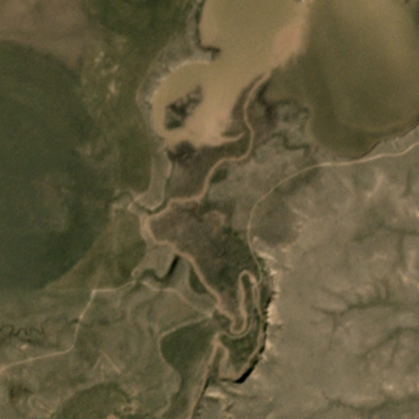

[] []
[b'workspace/dam_images/119391_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [65.0] [354.0] [95.0] [323.0]
Detection - Bounding box at [] [] [] []


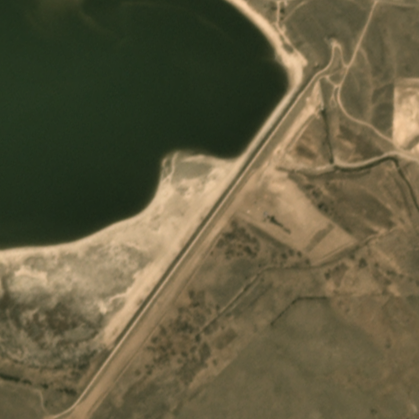

[] []
[b'workspace/dam_images/118986_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [193.0] [225.0] [157.0] [261.0]
Detection - Bounding box at [] [] [] []


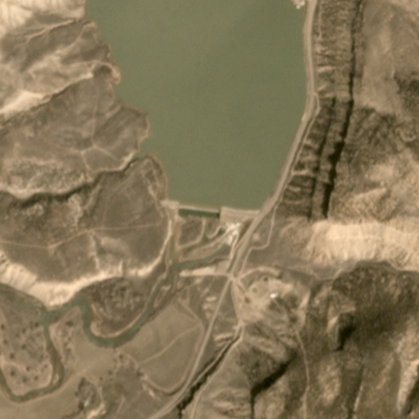

[] []
[b'workspace/dam_images/99627_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [194.0] [223.0] [118.0] [300.0]
Detection - Bounding box at [] [] [] []


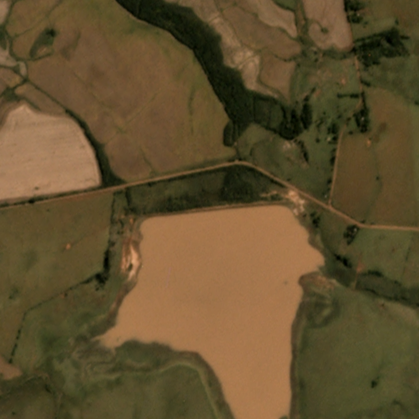

[] []
[b'workspace/dam_images/5134_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [131.0] [288.0] [139.0] [280.0]
Detection - Bounding box at [] [] [] []


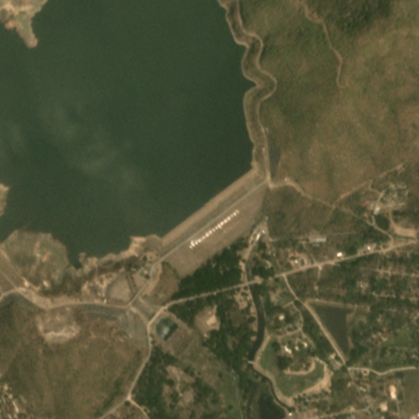

[] []
[b'workspace/dam_images/7332_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [193.0] [226.0] [178.0] [241.0]
Detection - Bounding box at [] [] [] []


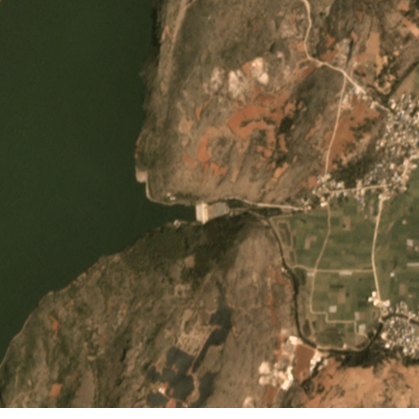

[] []
[b'workspace/not_a_dam_images/406-1254_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


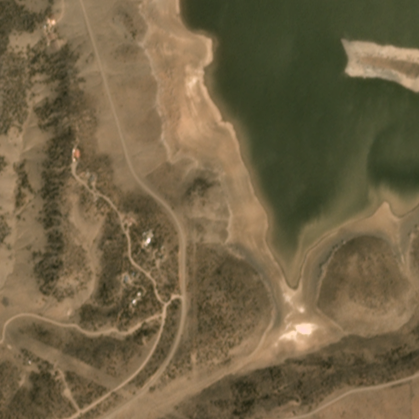

[] []
[b'workspace/not_a_dam_images/640-1313_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


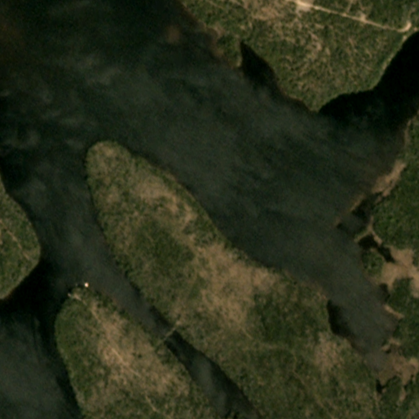

[] []
[b'workspace/not_a_dam_images/1296-912_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


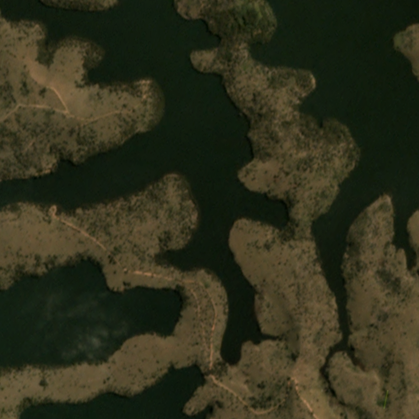

[] []
[b'workspace/dam_images/16577_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [203.0] [215.0] [182.0] [236.0]
Detection - Bounding box at [] [] [] []


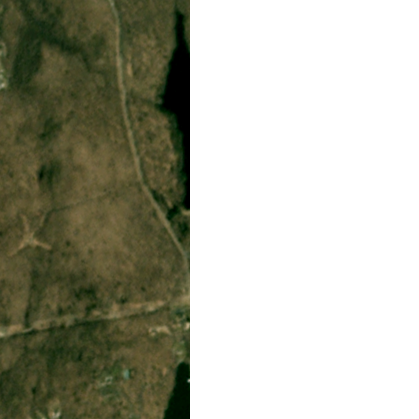

[] []
[b'workspace/not_a_dam_images/580-1255_not_a_dam.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


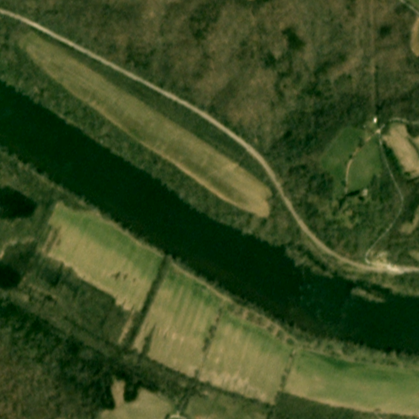

[] []
[b'workspace/dam_images/452_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [-3.0] [422.0] [0.0] [549.0]
Detection - Bounding box at [] [] [] []


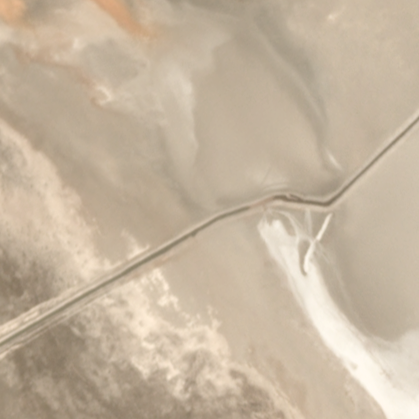

[] []
[b'workspace/dam_images/120104_clipped.png'] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [156.0] [263.0] [142.0] [276.0]
Detection - Bounding box at [] [] [] []


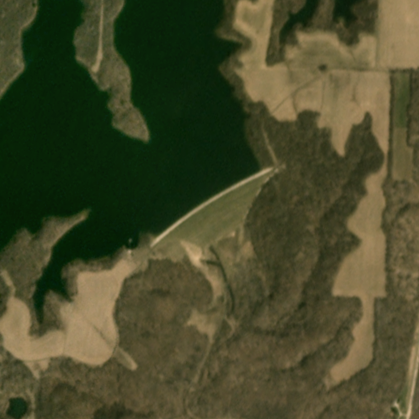

In [22]:
dataset_path = dataset_path_0527_bbtoobig

sess = tf.InteractiveSession()

for i in range(0,len(list(glob.glob(dataset_path)))):
    
    TFRECORDS_PATH = list(glob.glob(dataset_path))[i]
    
    inspect_tfrecord(TFRECORDS_PATH,only_first_image=True)
    

## Utils

In [21]:
def inspect_tfrecord(TFRECORDS_PATH,
                        only_first_image=False):
    
    record_iterator = tf.python_io.tf_record_iterator(TFRECORDS_PATH)

    for string_record in record_iterator:
        example = tf.train.Example()
        example.ParseFromString(string_record)
        
        ## Print infos:
        
        #temp
        label = example.features.feature['image/object/class/label'].bytes_list.value
        text = example.features.feature['image/object/class/text'].int64_list.value
        print(label, text)
        
        fn = example.features.feature['image/filename'].bytes_list.value
        fid= example.features.feature['image/id'].int64_list.value
        print(fn, 'id: ', fid)

        w = example.features.feature['image/width'].int64_list.value[0]
        h = example.features.feature['image/height'].int64_list.value[0]
        print('Image size: ',w,'*',h)

        bb_y0 = example.features.feature['image/object/bbox/ymin'].float_list.value
        bb_y1 = example.features.feature['image/object/bbox/ymax'].float_list.value
        bb_x0 = example.features.feature['image/object/bbox/xmin'].float_list.value
        bb_x1 = example.features.feature['image/object/bbox/xmax'].float_list.value
        print('Object BBox - Bounding box at', bb_y0, bb_y1, bb_x0, bb_x1)

        bb_y0_pred = example.features.feature['image/detection/bbox/ymin'].int64_list.value
        bb_y1_pred = example.features.feature['image/detection/bbox/ymax'].int64_list.value
        bb_x0_pred = example.features.feature['image/detection/bbox/xmin'].int64_list.value
        bb_x1_pred = example.features.feature['image/detection/bbox/xmax'].int64_list.value
        print('Detection - Bounding box at', bb_y0_pred, bb_y1_pred, bb_x0_pred, bb_x1_pred)

        ## Other things of interest could include:
        # label= example.features.feature['image/class/label'].int64_list.value
        # print(label)
        # fid= example.features.feature['image/class/text'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/class/conf'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/label'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/text'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/conf'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/bbox/score'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/object/parts/x'].int64_list.value
        # print(fid)
        # fid= example.features.feature['image/detection/bbox/xmin'].int64_list.value
        # print(fid)

        ## See https://github.com/microsoft/CameraTraps/blob/master/data_management/tfrecords/tools/iterate_tfrecords.py 
        ## for more attributes.

        
        encoded = example.features.feature["image/encoded"].bytes_list.value[0]
        img = PIL.Image.open(io.BytesIO(encoded))
        
        
#         if bb_y0 is True:
#             vis_utils.draw_bounding_box_on_image(img,
#                                ymin=bb_y0,xmin=bb_x0,ymax=bb_y1,xmax=bb_x1,
#                                color='green',
#                                thickness=4,
#                                display_str_list=('real'),
#                                use_normalized_coordinates=True)
            
#         if bb_y0_pred is True:
#             vis_utils.draw_bounding_box_on_image(img,
#                                ymin=bb_y0_pred,xmin=bb_x0_pred,ymax=bb_y1_pred,xmax=bb_x1_pred,
#                                color='red',
#                                thickness=4,
#                                display_str_list=('predict'),
#                                use_normalized_coordinates=True)
        
        display(img)
        
        if only_first_image == True:
            break


### Visualize past datasets 

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


/usr/local/lib/python3.5/dist-packages/tensorflow/python/client/session.py:1714: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


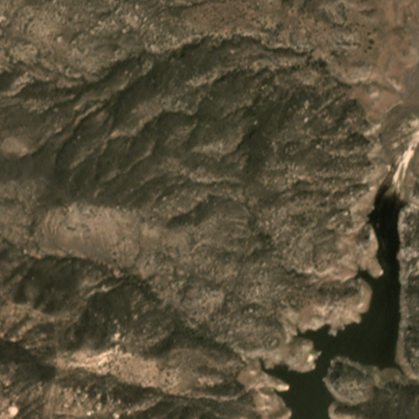

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


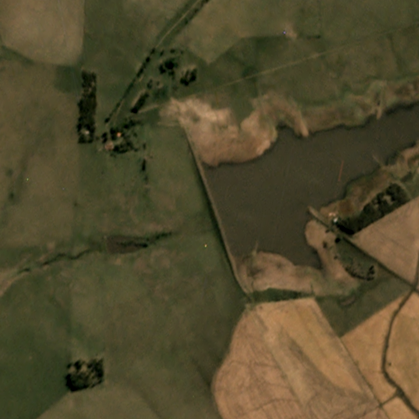

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


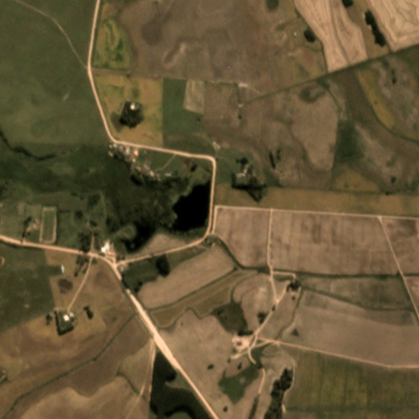

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


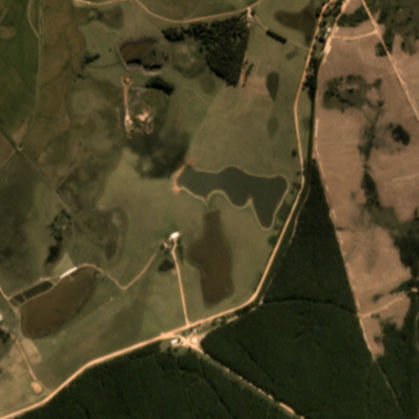

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


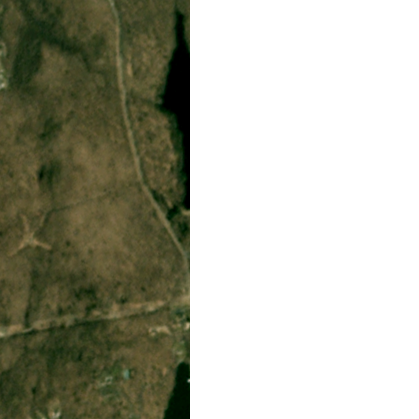

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


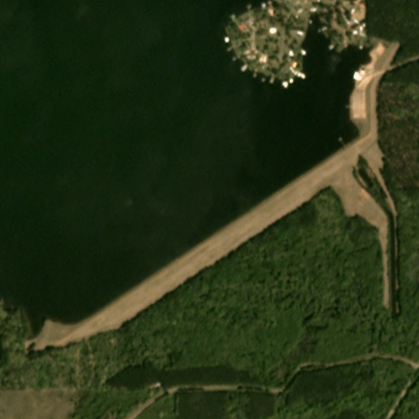

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


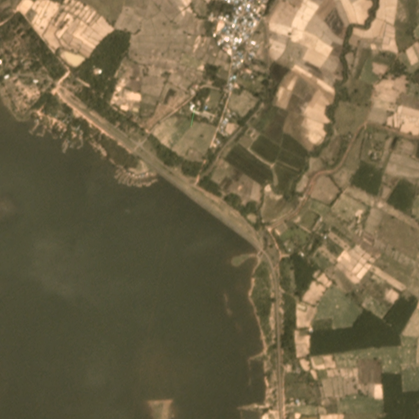

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


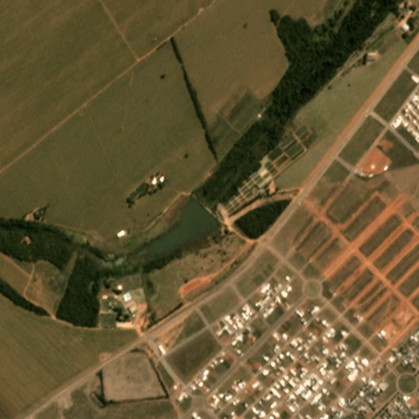

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


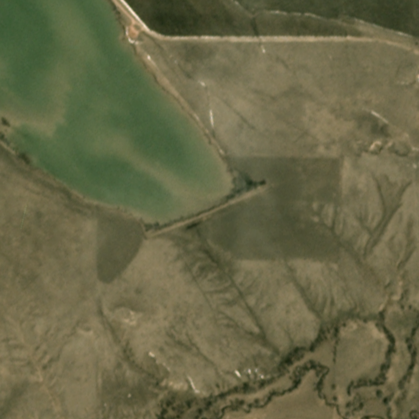

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


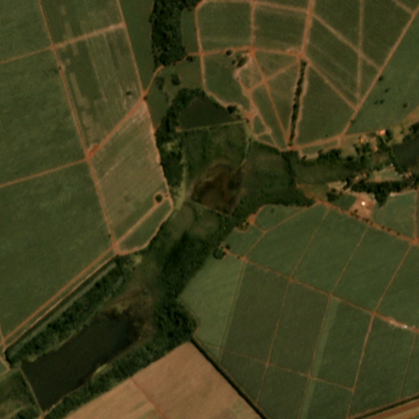

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


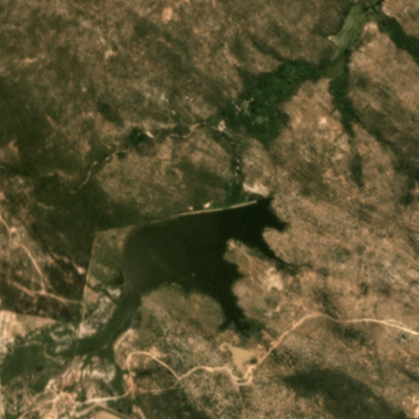

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


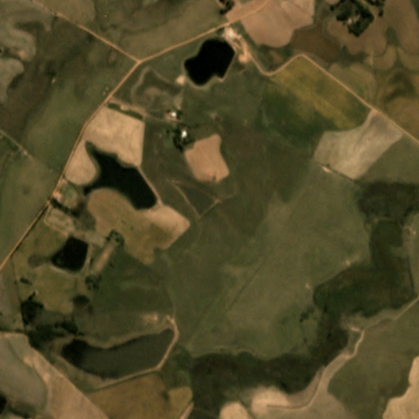

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


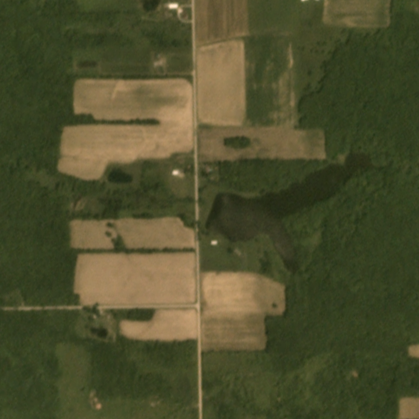

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


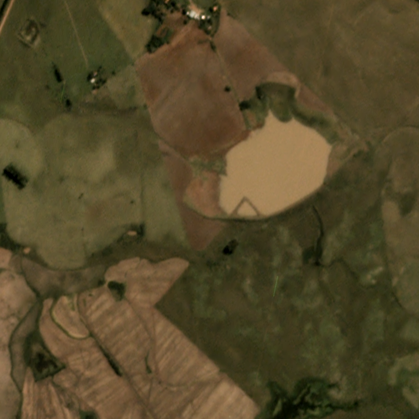

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


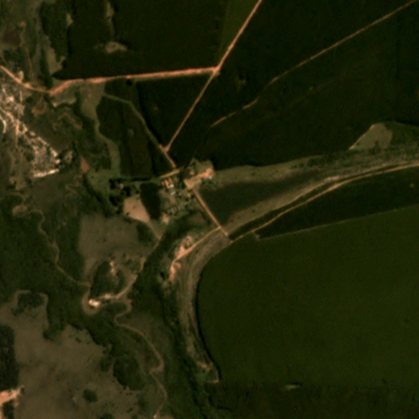

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


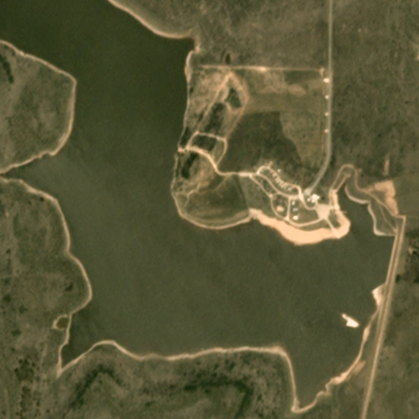

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


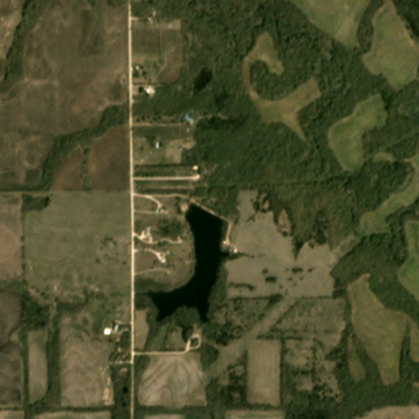

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


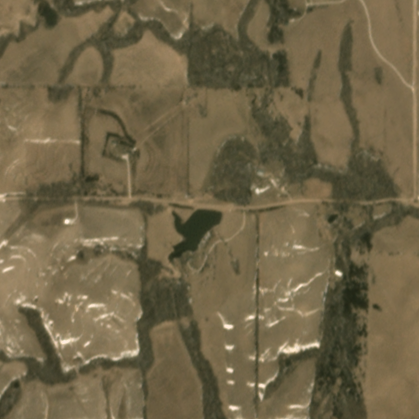

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


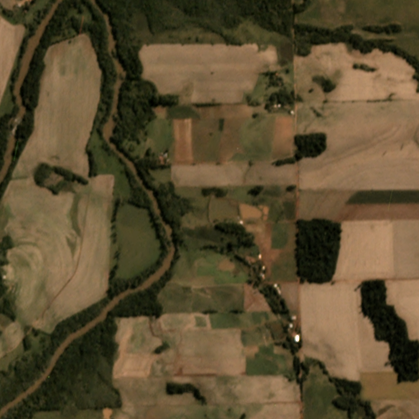

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


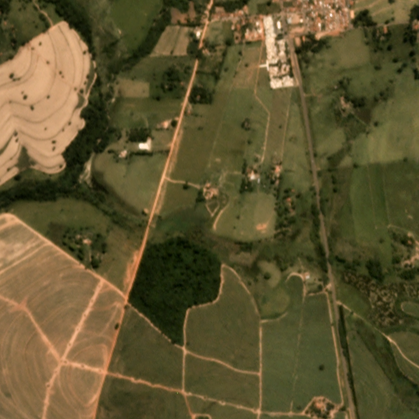

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


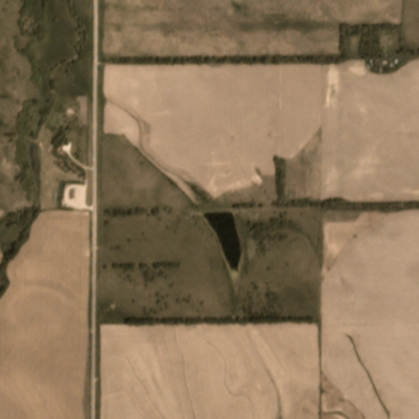

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


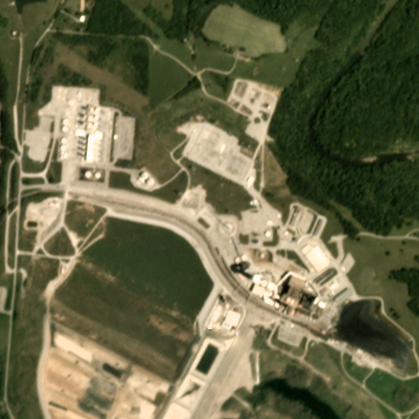

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


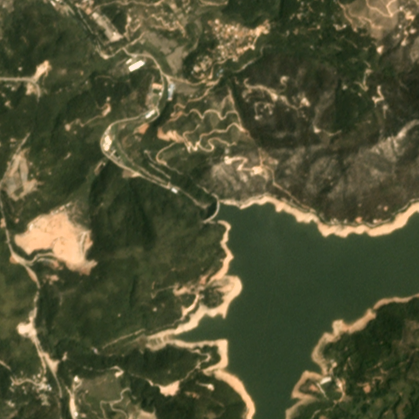

[] id:  []
Image size:  419 * 419
Object BBox - Bounding box at [] [] [] []
Detection - Bounding box at [] [] [] []


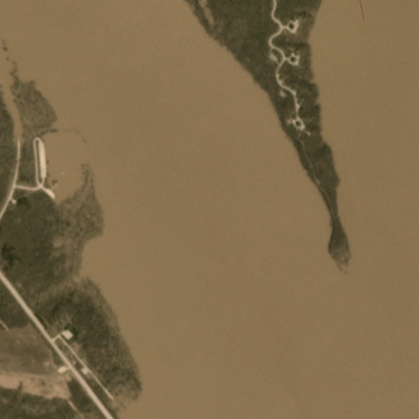

In [141]:
dataset_path = dataset_path_0513_nobb

sess = tf.InteractiveSession()

for i in range(0,len(list(glob.glob(dataset_path)))):
    
    TFRECORDS_PATH = list(glob.glob(dataset_path))[i]
    
    inspect_tfrecord(TFRECORDS_PATH,only_first_image=True)
    

## See Also

* https://github.com/microsoft/CameraTraps/blob/master/detection/run_tf_detector.py
* https://github.com/microsoft/CameraTraps/blob/master/data_management/tfrecords/tools/iterate_tfrecords.py
* https://github.com/tensorflow/models/blob/master/research/object_detection/inference/infer_detections.py

In [21]:
### I NEED THE IMAGES IN FILES LINKED TO THE TFRECORDS

im_path = example.features.feature["image/filename"].bytes_list.value[0].decode('utf8')
print(im_path)
print(PIL.Image.open(im_path).size)
PIL.Image.open(im_path)

workspace/not_a_dam_images/360-1221_not_a_dam.png


FileNotFoundError: [Errno 2] No such file or directory: 'workspace/not_a_dam_images/360-1221_not_a_dam.png'

## Visualize model results
From https://www.edureka.co/blog/tensorflow-object-detection-tutorial/#tutorial-1

### Extract model + inference graph from my model

In [ ]:
# Example

MODEL_NAME = 'ssd_mobilenet_v1_coco_2017_11_17'
MODEL_FILE = MODEL_NAME + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
 
PATH_TO_CKPT = MODEL_NAME + '/frozen_inference_graph.pb'
 
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')
 
NUM_CLASSES = 90

opener = urllib.request.URLopener()
opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
tar_file = tarfile.open(MODEL_FILE)
for file in tar_file.getmembers():
  file_name = os.path.basename(file.name)
  if 'frozen_inference_graph.pb' in file_name:
    tar_file.extract(file, os.getcwd())
 
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

### Load labels & images

In [ ]:
#Next, we are going to load all the labels
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

#Now we will convert the images data into a numPy array for processing.
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

PATH_TO_TEST_IMAGES_DIR = 'test_images'
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, 'image{}.jpg'.format(i)) for i in range(1, 8) ]
 

### Inference for a single image

In [ ]:
def run_inference_for_single_image(image, graph):
  with graph.as_default():
    with tf.Session() as sess:
    # Get handles to input and output tensors
      ops = tf.get_default_graph().get_operations()
      all_tensor_names = {output.name for op in ops for output in op.outputs}
      tensor_dict = {}
      for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
     ]:
        tensor_name = key + ':0'
        if tensor_name in all_tensor_names:
          tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
            tensor_name)
      if 'detection_masks' in tensor_dict:
        # The following processing is only for single image
        detection_boxes = tf.squeeze(tensor_dict['detection_boxes'], [0])
        detection_masks = tf.squeeze(tensor_dict['detection_masks'], [0])
        # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
        real_num_detection = tf.cast(tensor_dict['num_detections'][0], tf.int32)
        detection_boxes = tf.slice(detection_boxes, [0, 0], [real_num_detection, -1])
        detection_masks = tf.slice(detection_masks, [0, 0, 0], [real_num_detection, -1, -1])
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
            detection_masks, detection_boxes, image.shape[0], image.shape[1])
        detection_masks_reframed = tf.cast(
            tf.greater(detection_masks_reframed, 0.5), tf.uint8)
        # Follow the convention by adding back the batch dimension
        tensor_dict['detection_masks'] = tf.expand_dims(
            detection_masks_reframed, 0)
        image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')
 
        # Run inference
        output_dict = sess.run(tensor_dict,
            feed_dict={image_tensor: np.expand_dims(image, 0)})
 
        # all outputs are float32 numpy arrays, so convert types as appropriate
        output_dict['num_detections'] = int(output_dict['num_detections'][0])
        output_dict['detection_classes'] = output_dict[
          'detection_classes'][0].astype(np.uint8)
        output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
        output_dict['detection_scores'] = output_dict['detection_scores'][0]
        if 'detection_masks' in output_dict:
          output_dict['detection_masks'] = output_dict['detection_masks'][0]
return output_dict

### Final loop & viz

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  image = Image.open(image_path)
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = load_image_into_numpy_array(image)
  # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
  image_np_expanded = np.expand_dims(image_np, axis=0)
  # Actual detection.
  output_dict = run_inference_for_single_image(image_np, detection_graph)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks'),
      use_normalized_coordinates=True,
      line_thickness=8)
plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np)